### Imports and utils

In [0]:
!pip install tableone --quiet
!pip install geopandas --quiet
!pip install venn --quiet

You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-e3ec1aae-4e4c-45c6-b0c7-1dd8274bd779/bin/python -m pip install --upgrade pip' command.
You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-e3ec1aae-4e4c-45c6-b0c7-1dd8274bd779/bin/python -m pip install --upgrade pip' command.
You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-e3ec1aae-4e4c-45c6-b0c7-1dd8274bd779/bin/python -m pip install --upgrade pip' command.


In [0]:
import sys
if sys.version_info[0] == 3 and sys.version_info[1] < 7:
  from packaging import version
else:
  from distutils.version import LooseVersion

from io import StringIO
import pandas as pd
import numpy as np

from pyspark.sql import functions as F
from tableone import TableOne

import seaborn as sns
from matplotlib import pyplot as plt

/databricks/python/lib/python3.9/site-packages/seaborn/rcmod.py:82: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(mpl.__version__) >= "3.0":
/databricks/python/lib/python3.9/site-packages/setuptools/_distutils/version.py:351: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


In [0]:
def show_pandas_DF(pd_DF):
  displayHTML(pd_DF.to_html(index=False))
  
# Function takes as an input age and output the group
def age_groups(x):
    if x <18:
        return "0-17"
    if x>=18 and x<30:
        return "18-29"
    if x>=30 and x<50:
        return "30-49"      
    if x>=50 and x<65:
        return "50-64"            
    if x>=65:
        return "65+"  
      
#Function to convert a number into a human format (adds letters at the end of the number)
def human_format(num):
    magnitude = 0
    while abs(num) >= 1000:
        magnitude += 1
        num /= 1000.0
    # add more suffixes if you need them
    return '%.2f%s' % (num, ['', 'k', 'm', 'b', 't', 'p'][magnitude])


def plot_patients_by_age_gender(covid):  
  plt.style.use('seaborn-whitegrid')
  sns.set_palette("muted")

  bins = [i for i in range(df.age.max())] 
  f1,(ax0,ax1)=plt.subplots(nrows=1,ncols=2,sharey=True,figsize=(6,6)) 
  sns.distplot(df[(df.gender=='Male')&(df.COVID_Status==covid)].age, vertical=True,kde=False,ax=ax0,bins=bins, color='#1f33d1') 
  sns.distplot(df[(df.gender=='Female')&(df.COVID_Status==covid)].age, vertical=True,kde=False,ax=ax1,bins=bins, color='#d1c6ff') 

  ax0.set_title('Male') 
  ax1.set_title('Female') 
  ax0.invert_xaxis()
  ax0.grid(False)
  ax1.grid(False)
  ax0.set_xlabel('# of Persons', fontsize=13, labelpad=20)# #fontweight ='bold',
  ax1.set_xlabel('# of Persons', fontsize=13, labelpad=20)#, fontsize=14, labelpad=20)
  ax1.set_ylim(0,110)
  ax1.set(ylabel=None)
  sns.despine(bottom = False, left = True)
  sns.set(font='Helvetica')
  f1.suptitle(covid, fontsize = 14, fontweight ='bold')

Create widgets for database name

In [0]:
dbutils.widgets.removeAll()
dbutils.widgets.combobox("databaseName", "crisp_sep2021",["crisp_jan2022","crisp_sep2021","crisp_apr2021"], "CRISP database name")
dbutils.widgets.combobox("vocabdatabaseName", "omop_vocab_20220602",["omop_vocab_20220602","omop_vocab_20220204"], "OMOP Vocabulary database name")
dbutils.widgets.text("omopconcepts", "omop_concepts", "Concept Sets Database")

In [0]:
databaseName = dbutils.widgets.get("databaseName")
vocabdatabaseName = dbutils.widgets.get("vocabdatabaseName")
omopconcepts = dbutils.widgets.get("omopconcepts")

### Upload concept sets and create temp views

In [0]:
%sql
CREATE OR REPLACE TEMPORARY VIEW COVID_LABS_CONCEPT_SET AS select * from ${omopconcepts}.concept_sets where concept_set_name in ("N3C Covidantibody","ATLAS SARS-CoV-2 rt-PCR and AG");
CREATE OR REPLACE TEMPORARY VIEW COVID_RESULTSPOS_CONCEPT_SET AS select * from ${omopconcepts}.concept_sets where concept_set_name='Positive Result';
CREATE OR REPLACE TEMPORARY VIEW COVID_VENT_CONCEPT_SET AS select * from ${omopconcepts}.concept_sets_v2 where concept_set_name in ('[ICU/MODS]IMV','Kostka - ECMO');

--Temp view with of covid lab tests from measurement domain table
CREATE OR REPLACE TEMPORARY VIEW COVID_TESTS
    AS select m.*, c.concept_name, c.concept_name as covid_status      
       from ${databaseName}.measurement m 
          join ${vocabdatabaseName}.CONCEPT c on m.value_as_concept_id = c.concept_id 
       where m.measurement_concept_id in (select distinct Concept_Id from COVID_LABS_CONCEPT_SET);


In [0]:
%sql
-- Positive Lab confirmed covid tests from measurement domain table
CREATE OR REPLACE TEMPORARY VIEW COVID_POSITIVE_LAB_CONFIRMED_POSITIVE_TESTS
    AS select m.*, c.concept_name, 'Positive' as covid_status      
       from ${databaseName}.measurement m 
          join ${vocabdatabaseName}.CONCEPT c on m.value_as_concept_id = c.concept_id 
       where m.measurement_concept_id in (select distinct Concept_Id from COVID_LABS_CONCEPT_SET) 
         AND (m.value_as_concept_id in (select distinct Concept_Id from COVID_RESULTSPOS_CONCEPT_SET)
         OR m.value_as_concept_id in (36310893, 0, 45876384)) --OR (m.value_as_concept_id==0 AND (lower(m.measurement_source_value) like '%abnormal%' or lower(m.measurement_source_value) like '%change up%'));       


In [0]:
%sql

-- Positive Lab confirmed persons  from measurement domain table
CREATE OR REPLACE TEMPORARY VIEW COVID_POSITIVE_LAB_CONFIRMED_PERSONS
    AS select distinct m.person_id    
       from ${databaseName}.measurement m 
       where m.measurement_concept_id in (select distinct Concept_Id from COVID_LABS_CONCEPT_SET) 
         AND (m.value_as_concept_id in (select distinct Concept_Id from COVID_RESULTSPOS_CONCEPT_SET)
         OR m.value_as_concept_id in (36310893, 0, 45876384)) --OR (m.value_as_concept_id==0 AND (lower(m.measurement_source_value) like '%abnormal%' or lower(m.measurement_source_value) like '%change up%'));  
      

In [0]:
%sql
   
-- Covid diagnosed persons
CREATE OR REPLACE TEMPORARY VIEW COVID_DIAGNOSED_PERSONS
AS Select distinct person_id  
   from ${databaseName}.condition_occurrence_domain_map 
   where condition_concept_id=37311061;        



In [0]:
%sql

-- Lab confirmed or diagnosed persons
CREATE OR REPLACE TEMPORARY VIEW COVID_POSITIVE_PERSONS
AS select person_id from COVID_DIAGNOSED_PERSONS
   union
   select person_id from COVID_POSITIVE_LAB_CONFIRMED_PERSONS;
   

In [0]:
%sql

-- Persons not tested for COVID (in measurement) AND not diagnosed with COVID (in condition_occurrence) -- POSSIBLE CONTROLS
CREATE OR REPLACE TEMPORARY VIEW COVID_NOT_TESTED_AND_NOT_DIAGNOSED_PERSONS
AS select distinct person_id from ${databaseName}.person
   where person_id not in (select distinct person_id from COVID_TESTS union select person_id from COVID_DIAGNOSED_PERSONS);   
   

In [0]:
%sql

-- Negative Lab confirmed covid tests from measurement domain table
CREATE OR REPLACE TEMPORARY VIEW COVID_NEGATIVE_LAB_TESTS
    AS select m.*, c.concept_name, 'Negative' as covid_status      
       from ${databaseName}.measurement m 
          join ${vocabdatabaseName}.CONCEPT c on m.value_as_concept_id = c.concept_id 
       where m.measurement_concept_id in (select distinct Concept_Id from COVID_LABS_CONCEPT_SET) 
         AND c.concept_name in ('Negative','Normal');


In [0]:
%sql

-- Inconclusive Lab covid tests from measurement domain table
CREATE OR REPLACE TEMPORARY VIEW COVID_INCONCLUSIVE_LAB_TESTS
    AS select m.*, c.concept_name, 'Inconclusive' as covid_status      
       from ${databaseName}.measurement m 
          join ${vocabdatabaseName}.CONCEPT c on m.value_as_concept_id = c.concept_id 
       where m.measurement_concept_id in (select distinct Concept_Id from COVID_LABS_CONCEPT_SET) 
         AND c.concept_name in ('Inconclusive');
   

In [0]:
%sql
               
-- Persons with Covid Negative Lab without a Positive test AND Not diagnosed with covid  -- POSSIBLE CONTROLS
CREATE OR REPLACE TEMPORARY VIEW COVID_NEGATIVE_PERSONS
    AS select distinct person_id from COVID_NEGATIVE_LAB_TESTS
    where person_id not in (select person_id from COVID_POSITIVE_PERSONS);           
            

In [0]:
%sql
        
-- Persons with Covid Inconclusive Lab without a Positive or Negative test AND Not diagnosed with covid 
CREATE OR REPLACE TEMPORARY VIEW COVID_INCONCLUSIVE_PERSONS
    AS select distinct person_id from COVID_INCONCLUSIVE_LAB_TESTS
    where person_id not in (select person_id from COVID_POSITIVE_PERSONS union select person_id from COVID_NEGATIVE_PERSONS);     


In [0]:
%sql
-- Persons table with covid status
CREATE OR REPLACE TEMPORARY VIEW PERSONS_COVID_STATUS
  AS select p.*, CASE WHEN pos.person_id is not null THEN 'Positive'
               WHEN neg.person_id is not null THEN 'Negative'
               WHEN inc.person_id is not null THEN 'Inconclusive'
               WHEN ntst.person_id is not null THEN 'Not tested'
               ELSE null END covid_status              
  from ${databaseName}.person p
  left join COVID_POSITIVE_PERSONS pos on p.person_id= pos.person_id
  left join COVID_NEGATIVE_PERSONS neg on p.person_id= neg.person_id
  left join COVID_INCONCLUSIVE_PERSONS inc on p.person_id= inc.person_id
  left join COVID_NOT_TESTED_AND_NOT_DIAGNOSED_PERSONS ntst on p.person_id= ntst.person_id;

In [0]:
positive_patients_query="""Select count(*) patients from COVID_POSITIVE_PERSONS"""
dataframe = sqlContext.sql(positive_patients_query)
pandasDF = dataframe.toPandas()
pandasDF = pandasDF.patients.apply(lambda x : "{:,}".format(x))
positive_patients = pandasDF[0]

covid_tests_query="""Select count(*) tests from COVID_TESTS"""
dataframe = sqlContext.sql(covid_tests_query)
pandasDF = dataframe.toPandas()
pandasDF = pandasDF.tests.apply(lambda x : "{:,}".format(x))
covid_tests = pandasDF[0]

all_patients_query="""Select count(*) patients from """+databaseName+""".person"""
dataframe = sqlContext.sql(all_patients_query)
pandasDF = dataframe.toPandas()
pandasDF = pandasDF.patients.apply(lambda x : "{:,}".format(x))
all_patients = pandasDF[0]

care_sites_query="""Select count(distinct care_site_name) care_sites from """+databaseName+""".visit_occurrence"""
dataframe = sqlContext.sql(care_sites_query)
pandasDF = dataframe.toPandas()
pandasDF = pandasDF.care_sites.apply(lambda x : "{:,}".format(x))
care_sites = pandasDF[0]


visits_query="""Select count(distinct visit_occurrence_id) visits from """+databaseName+""".visit_occurrence"""
dataframe = sqlContext.sql(visits_query)
pandasDF = dataframe.toPandas()
visits = human_format(pandasDF.visits[0])

procedures_query="""Select count(procedure_occurrence_id) procedures from """+databaseName+""".procedure_occurrence"""
dataframe = sqlContext.sql(procedures_query)
pandasDF = dataframe.toPandas()
procedures = human_format(pandasDF.procedures[0])

observations_query="""Select count(observation_id) observations from """+databaseName+""".observation"""
dataframe = sqlContext.sql(observations_query)
pandasDF = dataframe.toPandas()
observations = human_format(pandasDF.observations[0])

labs_query="""Select count(measurement_id) labs from """+databaseName+""".measurement"""
dataframe = sqlContext.sql(labs_query)
pandasDF = dataframe.toPandas()
labs = human_format(pandasDF.labs[0])

drug_exposures_query="""Select count(drug_exposure_id) drug_exposures from """+databaseName+""".drug_exposure"""
dataframe = sqlContext.sql(drug_exposures_query)
pandasDF = dataframe.toPandas()
drug_exposures = human_format(pandasDF.drug_exposures[0])

death_query="""Select count(person_id) persons from """+databaseName+""".death"""
dataframe = sqlContext.sql(death_query)
pandasDF = dataframe.toPandas()
deaths = human_format(pandasDF.persons[0])



/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distuti

In [0]:

person_cnt=sqlContext.sql("""Select count(*) person from """+databaseName+""".person""").toPandas().person[0]
procedure_cnt=sqlContext.sql("""Select count(*) procedure from """+databaseName+""".procedure_occurrence""").toPandas().procedure[0]
measurement_cnt=sqlContext.sql("""Select count(*) measurement from """+databaseName+""".measurement""").toPandas().measurement[0]
drug_exposure_cnt=sqlContext.sql("""Select count(*) drug from """+databaseName+""".drug_exposure""").toPandas().drug[0]
visit_cnt=sqlContext.sql("""Select count(*) visit from """+databaseName+""".visit_occurrence""").toPandas().visit[0]
observation_cnt=sqlContext.sql("""Select count(*) observation from """+databaseName+""".observation""").toPandas().observation[0]

row_cnt=person_cnt + procedure_cnt + measurement_cnt + drug_exposure_cnt + visit_cnt + observation_cnt
#Total rows of data = sum of rows in the following OMOP domain  ( person, procedure, measurement, drug_exposure, visits, observation )
row_cnt_human=human_format(row_cnt)

/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distuti

In [0]:
displayHTML("""

<!DOCTYPE html>
<html>
<head>
<!-- Bootstrap CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@5.0.2/dist/css/bootstrap.min.css">
    <!-- Bootstrap Font Icon CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap-icons@1.5.0/font/bootstrap-icons.css">
<style>
.center {
  margin-left: 20px;
  width: 100%;
}
.value-large {
    margin-top: 20px;
    color: #4B6AB2;
    font-size: 28px;
    line-height: 32px;
    font-weight: 600;
    padding-right: 100px;
}
.title {
    color: #8a9ba8;
    font-size: 12px;
    font-weight: 600;
    letter-spacing: 0.5px;
    text-transform: uppercase;
    padding-right: 70px;
    padding-top: 10px;
}
.text {
    display: inline-block;
    margin-top: 6px;
}
hr {
    margin-top: 20px;
    margin-left: 10px;
    background-color: #D3D3D3;
    border: none;
    height: 0.5px;
}
.value-small {
    color: #4B6AB2;
    font-size: 23px;
    line-height: 25px;
    font-weight: 600;
    padding-right: 70px;    
}
</style>
</head>
<body>
<table class='center'>
  <tr>
    <td>
      <div class="value-large"><i class="bi-person"></i> """+str(positive_patients)+"""</div>
      <div class="title">Positive Patients</div>        
    </td>
    <td>
      <div class="value-large"><i class="bi-bag-plus"></i> """+str(covid_tests)+"""</div>
      <div class="title">COVID Tests</div>        
    </td>
    <td>
      <div class="value-large"><i class="bi-people"></i> """+str(all_patients)+"""</div>
      <div class="title">Total Patients</div>        
    </td>
    <td>
      <div class="value-large"><i class="bi-building"></i> """+str(care_sites)+"""</div>
      <div class="title">Care Sites</div>        
    </td>
    <td>
      <div class="value-large"><i class="bi-building"></i> """+str(row_cnt_human)+"""</div>
      <div class="title">Total row counts</div>        
    </td>
  </tr>
</table>
  <hr>
<table class='center'>
  <tr>
    <td>
      <div class="value-small">"""+str(visits)+"""</div>
      <div class="title">Visits</div>        
    </td>
    <td>
      <div class="value-small"></i> """+str(procedures)+"""</div>
      <div class="title">Procedures</div>        
    </td>
    <td>
      <div class="value-small">"""+str(observations)+"""</div>
      <div class="title">Observations</div>        
    </td>
    <td>
      <div class="value-small">"""+str(labs)+"""</div>
      <div class="title">Labs</div>        
    </td>
    <td>
      <div class="value-small">"""+str(drug_exposures)+"""</div>
      <div class="title">Drug Exposures</div>        
    </td>
    <td>
      <div class="value-small">"""+str(deaths)+"""</div>
      <div class="title">Deaths</div>        
    </td>        
  </tr>
</table>
  <hr>
</body>
</html>

""")


<!DOCTYPE html>
 
 
<!-- Bootstrap CSS -->
 
 <!-- Bootstrap Font Icon CSS -->
 

 
 
 
 
 
 1,500,778 
 Positive Patients 
 
 
 29,272,304 
 COVID Tests 
 
 
 6,103,600 
 Total Patients 
 
 
 56 
 Care Sites 
 
 
 475.98m 
 Total row counts 
 
 
 
 
 
 
 
 18.11m 
 Visits 
 
 
 3.49m 
 Procedures 
 
 
 26.48m 
 Observations 
 
 
 412.45m 
 Labs 
 
 
 8.95m 
 Drug Exposures 
 
 
 101.08k 
 Deaths

In [0]:
#dataframe = sqlContext.sql("select gender_concept_id gender, count(*) patients_count from ${databaseName}.person group by gender_concept_id")
#display(dataframe)
#pandasDF = dataframe.toPandas()
#print(pandasDF.to_string(index=False))
#show_pandas_DF(pandasDF)

In [0]:
%sql
CACHE TABLE PERSONS_COVID_STATUS_CACHED AS SELECT * FROM PERSONS_COVID_STATUS

person_id,gender_concept_id,mapped_gender,year_of_birth,month_of_birth,day_of_birth,birth_datetime,race_concept_id,ethnicity_concept_id,location_id,provider_id,care_site_id,person_source_value,gender_source_value,gender_source_concept_id,race_source_value,race_source_concept_id,ethnicity_source_value,ethnicity_source_concept_id,run_timestamp,covid_status
30000077,8532,F,1958,11,0,null,8527,38003564,277494792755780,0,0,0,F,0,WHITE,0,NOT HISPANIC,0,2023-09-07T14:42:15.611+0000,Negative
30000117,8507,M,1945,8,0,null,45878142,38003563,913687812329670,0,0,0,M,0,OTHER,0,HISPANIC,0,2023-09-07T14:42:15.611+0000,Negative
30000295,8507,M,1951,3,0,null,8527,38003564,196593332507613,0,0,0,M,0,WHITE,0,NOT HISPANIC,0,2023-09-07T14:42:15.611+0000,Positive
30000464,8507,M,1992,3,0,null,8527,38003564,1893397212843166,0,0,0,M,0,WHITE,0,NOT HISPANIC,0,2023-09-07T14:42:15.611+0000,Negative
30000622,8507,M,1942,7,0,null,8527,38003564,1985517411265738,0,0,0,M,0,WHITE,0,NOT HISPANIC,0,2023-09-07T14:42:15.611+0000,Negative
30001902,8532,F,1954,4,0,null,8527,38003564,2026437023386419,0,0,0,F,0,WHITE,0,NOT HISPANIC,0,2023-09-07T14:42:15.611+0000,Negative
30001996,8532,F,1949,7,0,null,8527,38003564,1731359389173329,0,0,0,F,0,WHITE,0,NOT HISPANIC,0,2023-09-07T14:42:15.611+0000,Negative
30002221,8532,F,1980,12,0,null,45878142,38003563,2170020155988896,0,0,0,F,0,OTHER,0,HISPANIC,0,2023-09-07T14:42:15.611+0000,Positive
30002417,8532,F,1963,1,0,null,45878142,38003563,540925412647711,0,0,0,F,0,OTHER,0,HISPANIC,0,2023-09-07T14:42:15.611+0000,Negative
30002487,8507,M,1974,10,0,null,45878142,38003563,1067611200858674,0,0,0,M,0,OTHER,0,HISPANIC,0,2023-09-07T14:42:15.611+0000,Positive


In [0]:
%sql
SELECT count(*) from PERSONS_COVID_STATUS_CACHED

count(1)
6103600


### Queries

#### Gender Breakdown Query

In [0]:
%sql
select  
CASE
    WHEN gender==8532 THEN 'FEMALE'
    WHEN gender==8507 THEN 'MALE'
    WHEN gender==0 THEN 'UNKNOWN'
END Gender, patients_count Patients,
CONCAT(ROUND(patients_count * 100/(SELECT count(distinct person_id) from PERSONS_COVID_STATUS_CACHED),2),'%') Percentage
from (           
select gender_concept_id gender, count(distinct person_id) patients_count from PERSONS_COVID_STATUS_CACHED
group by gender_concept_id)x

Gender,Patients,Percentage
FEMALE,3203025,52.48%
MALE,2825205,46.29%
UNKNOWN,75370,1.23%


Databricks visualization. Run in Databricks to view.

#### Covid Status Breakdown Queries

In [0]:
%sql
Select count(p.person_id) as Patients, p.covid_status as COVID_Status
from PERSONS_COVID_STATUS_CACHED p group by p.covid_status ORDER BY COVID_Status, Patients

Patients,COVID_Status
9567,Inconclusive
4497989,Negative
95266,Not tested
1500778,Positive


In [0]:
%sql
Select p.person_id as Patients ,p.covid_status as COVID_Status,CASE
    WHEN gender_concept_id==8532 THEN 'FEMALE'
    WHEN gender_concept_id==8507 THEN 'MALE'
    WHEN gender_concept_id==0 THEN 'UNKNOWN'
END Gender from PERSONS_COVID_STATUS_CACHED p

Patients,COVID_Status,Gender
30000077,Negative,FEMALE
30000117,Negative,MALE
30000295,Positive,MALE
30000464,Negative,MALE
30000622,Negative,MALE
30001902,Negative,FEMALE
30001996,Negative,FEMALE
30002221,Positive,FEMALE
30002417,Negative,FEMALE
30002487,Positive,MALE


Databricks visualization. Run in Databricks to view.

In [0]:
 %sql
 select person_id Patients, covid_status as COVID_Status, CASE
      WHEN ethnicity_concept_id==38003563 THEN 'Hispanic or Latino'
      WHEN ethnicity_concept_id==38003564 THEN 'Not Hispanic or Latino'
      WHEN ethnicity_concept_id==0 THEN 'Unknown' 
  END Ethnicity from PERSONS_COVID_STATUS_CACHED p; 

Patients,COVID_Status,Ethnicity
30000077,Negative,Not Hispanic or Latino
30000117,Negative,Hispanic or Latino
30000295,Positive,Not Hispanic or Latino
30000464,Negative,Not Hispanic or Latino
30000622,Negative,Not Hispanic or Latino
30001902,Negative,Not Hispanic or Latino
30001996,Negative,Not Hispanic or Latino
30002221,Positive,Hispanic or Latino
30002417,Negative,Hispanic or Latino
30002487,Positive,Hispanic or Latino


In [0]:
dbutils.fs.ls("/mnt/crisp-covid/tables/")

Out[1]: [FileInfo(path='dbfs:/mnt/crisp-covid/tables/ATLAS_SARS.csv', name='ATLAS_SARS.csv', size=14215, modificationTime=1680887150000),
 FileInfo(path='dbfs:/mnt/crisp-covid/tables/ATLAS_SARS_CoV_2_rt_PCR_and_AG-1.csv', name='ATLAS_SARS_CoV_2_rt_PCR_and_AG-1.csv', size=10572, modificationTime=1680887150000),
 FileInfo(path='dbfs:/mnt/crisp-covid/tables/ATLAS_SARS_CoV_2_rt_PCR_and_AG-2.csv', name='ATLAS_SARS_CoV_2_rt_PCR_and_AG-2.csv', size=10572, modificationTime=1680887151000),
 FileInfo(path='dbfs:/mnt/crisp-covid/tables/ATLAS_SARS_CoV_2_rt_PCR_and_AG-3.csv', name='ATLAS_SARS_CoV_2_rt_PCR_and_AG-3.csv', size=10572, modificationTime=1680887151000),
 FileInfo(path='dbfs:/mnt/crisp-covid/tables/ATLAS_SARS_CoV_2_rt_PCR_and_AG.csv', name='ATLAS_SARS_CoV_2_rt_PCR_and_AG.csv', size=10572, modificationTime=1680887151000),
 FileInfo(path='dbfs:/mnt/crisp-covid/tables/Asthma-1.csv', name='Asthma-1.csv', size=17257, modificationTime=1680887151000),
 FileInfo(path='dbfs:/mnt/crisp-covid/tables

In [0]:
%sql
select p.person_id Patients, p.covid_status as COVID_Status, c.concept_name, CASE
      WHEN c.concept_name=='Other Mixed background - ethnic category 2001 census' THEN 'Other'
      WHEN c.concept_name=='American Indian or Alaska Native' THEN 'Other'
      WHEN c.concept_name=='Native Hawaiian or Other Pacific Islander' THEN 'Pacific Islander' 
      WHEN c.concept_name=='No matching concept' THEN 'Unknown'   
      ELSE c.concept_name
  END Race   
  from PERSONS_COVID_STATUS_CACHED p join ${vocabdatabaseName}.CONCEPT c 
  on p.race_concept_id = c.concept_id 

Patients,COVID_Status,concept_name,Race
30003003,Negative,Black or African American,Black or African American
30004312,Negative,Black or African American,Black or African American
30004465,Negative,Black or African American,Black or African American
30005179,Negative,Black or African American,Black or African American
30005558,Negative,Black or African American,Black or African American
30005572,Positive,Black or African American,Black or African American
30007983,Negative,Black or African American,Black or African American
30008059,Positive,Black or African American,Black or African American
30008202,Positive,Black or African American,Black or African American
30008724,Positive,Black or African American,Black or African American


In [0]:
%sql
select p.person_id Patients, p.covid_status as COVID_Status, p.year_of_birth, YEAR(current_date()) - p.year_of_birth AS AGE, CASE
      WHEN YEAR(current_date()) - p.year_of_birth >= 0 AND YEAR(current_date()) - p.year_of_birth < 18 THEN '0 - 17'
      WHEN YEAR(current_date()) - p.year_of_birth >= 18 AND YEAR(current_date()) - p.year_of_birth < 30 THEN '18 - 29'
      WHEN YEAR(current_date()) - p.year_of_birth >= 30 AND YEAR(current_date()) - p.year_of_birth < 50 THEN '30 - 49'      
      WHEN YEAR(current_date()) - p.year_of_birth >= 50 AND YEAR(current_date()) - p.year_of_birth < 65 THEN '50 - 64'      
      WHEN YEAR(current_date()) - p.year_of_birth >= 65 THEN '65+'      
      WHEN YEAR(current_date()) - p.year_of_birth < 0 OR YEAR(current_date()) - p.year_of_birth < 120 THEN 'Unknown'              
      WHEN p.year_of_birth==null THEN 'Unknown'   
  END Age_Groups   
  from PERSONS_COVID_STATUS_CACHED p ORDER BY Age_Groups

Patients,COVID_Status,year_of_birth,AGE,Age_Groups
30001130,Negative,2010,14,0 - 17
30037002,Positive,2009,15,0 - 17
30001481,Negative,2010,14,0 - 17
30037225,Positive,2010,14,0 - 17
30001235,Positive,2010,14,0 - 17
30052791,Negative,2009,15,0 - 17
30001574,Negative,2010,14,0 - 17
30059575,Negative,2009,15,0 - 17
30006899,Negative,2007,17,0 - 17
30066243,Negative,2009,15,0 - 17


####Patients by age and gender

In [0]:
query="""select p.person_id Patients, p.covid_status as COVID_Status, p.year_of_birth, YEAR(current_date()) - p.year_of_birth AS age, CASE
      WHEN YEAR(current_date()) - p.year_of_birth >= 0 AND YEAR(current_date()) - p.year_of_birth < 18 THEN '0 - 17'
      WHEN YEAR(current_date()) - p.year_of_birth >= 18 AND YEAR(current_date()) - p.year_of_birth < 30 THEN '18 - 29'
      WHEN YEAR(current_date()) - p.year_of_birth >= 30 AND YEAR(current_date()) - p.year_of_birth < 50 THEN '30 - 49'      
      WHEN YEAR(current_date()) - p.year_of_birth >= 50 AND YEAR(current_date()) - p.year_of_birth < 65 THEN '50 - 64'      
      WHEN YEAR(current_date()) - p.year_of_birth >= 65 THEN '65+'      
      WHEN YEAR(current_date()) - p.year_of_birth < 0 OR YEAR(current_date()) - p.year_of_birth < 120 THEN 'Unknown'              
      WHEN p.year_of_birth==null THEN 'Unknown'   
  END Age_Groups, CASE
    WHEN gender_concept_id==8532 THEN 'Female'
    WHEN gender_concept_id==8507 THEN 'Male'
    WHEN gender_concept_id==0 THEN 'Unkown'
END gender  
  from PERSONS_COVID_STATUS_CACHED p WHERE YEAR(current_date()) - p.year_of_birth>=0 AND YEAR(current_date()) - p.year_of_birth<120 AND gender_concept_id!=0"""
dataframe = sqlContext.sql(query)
#display(dataframe)
df = dataframe.toPandas()
#print(pandasDF.to_string(index=False))
#show_pandas_DF(pandasDF)


/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):


/databricks/python/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/databricks/python/lib/python3.9/site-packages/seaborn/rcmod.py:400: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(mpl.__version__) >= "3.0":
/databricks/python/lib/python3.9/site-packages/setuptools/_distutils/version.py:351: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


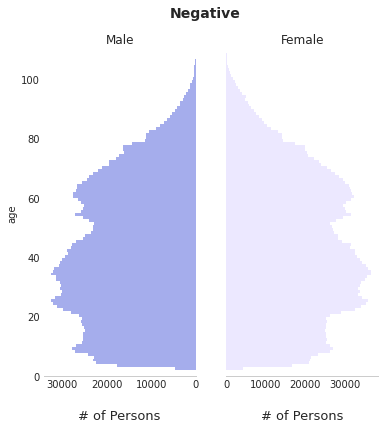

In [0]:
plot_patients_by_age_gender('Negative')

/databricks/python/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/databricks/python/lib/python3.9/site-packages/seaborn/rcmod.py:400: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(mpl.__version__) >= "3.0":
/databricks/python/lib/python3.9/site-packages/setuptools/_distutils/version.py:351: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


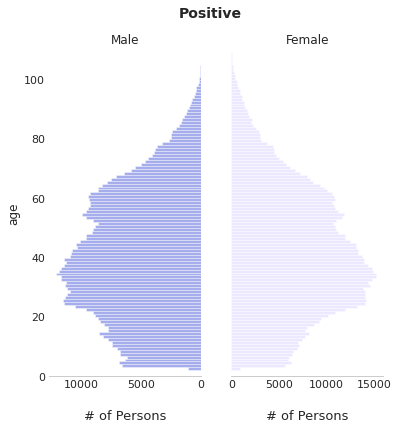

In [0]:
plot_patients_by_age_gender('Positive')

#### Summary statistics for all patients

In [0]:
query="""select p.person_id Patients, p.covid_status as COVID_Status,  YEAR(current_date()) - p.year_of_birth AS AGE, CASE
      WHEN YEAR(current_date()) - p.year_of_birth >= 0 AND YEAR(current_date()) - p.year_of_birth < 18 THEN '0 - 17'
      WHEN YEAR(current_date()) - p.year_of_birth >= 18 AND YEAR(current_date()) - p.year_of_birth < 30 THEN '18 - 29'
      WHEN YEAR(current_date()) - p.year_of_birth >= 30 AND YEAR(current_date()) - p.year_of_birth < 50 THEN '30 - 49'      
      WHEN YEAR(current_date()) - p.year_of_birth >= 50 AND YEAR(current_date()) - p.year_of_birth < 65 THEN '50 - 64'      
      WHEN YEAR(current_date()) - p.year_of_birth >= 65 THEN '65+'      
      WHEN YEAR(current_date()) - p.year_of_birth < 0 OR YEAR(current_date()) - p.year_of_birth < 120 THEN 'Unknown'              
      WHEN p.year_of_birth==null THEN 'Unknown'
  END Age_Groups, 
  CASE
    WHEN gender_concept_id==8532 THEN 'Female'
    WHEN gender_concept_id==8507 THEN 'Male'
    WHEN gender_concept_id==0 THEN 'Unknown'
    END Gender, 
  CASE
      WHEN ethnicity_concept_id==38003563 THEN 'Hispanic or Latino'
      WHEN ethnicity_concept_id==38003564 THEN 'Not Hispanic or Latino'
      WHEN ethnicity_concept_id==0 THEN 'Unknown' 
  END Ethnicity, 
  CASE
      WHEN c.concept_name=='Other Mixed background - ethnic category 2001 census' THEN 'Other'
      WHEN c.concept_name=='American Indian or Alaska Native' THEN 'Other'
      WHEN c.concept_name=='Native Hawaiian or Other Pacific Islander' THEN 'Pacific Islander' 
      WHEN c.concept_name=='No matching concept' THEN 'Unknown'   
      ELSE c.concept_name
  END Race, 
  CASE
      WHEN p.covid_status=='Positive' THEN 'COVID' 
      ELSE 'NON-COVID'
  END COVID
    from PERSONS_COVID_STATUS_CACHED p join """+vocabdatabaseName+""".CONCEPT c 
  on p.race_concept_id = c.concept_id ORDER BY Age_Groups"""
dataframe = sqlContext.sql(query)
df_table1 = dataframe.toPandas()


/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):


In [0]:
columns = ['Gender', 'Ethnicity', 'Age_Groups', 'Race', 'COVID']
categorical = ['Gender', 'Ethnicity', 'Age_Groups','Race']
groupby = 'COVID'
mytable = TableOne(df_table1, columns=columns, categorical=categorical, groupby=groupby)

TESTDATA = StringIO(mytable.to_csv())
df = pd.read_csv(TESTDATA, sep=",", header=1)
df.columns = [c + ' (N=' + str(df.iloc[0,i])+ ')'for i, c in enumerate(df.columns)]
# Drop first row 
df = df.iloc[1:,:]
df = df.drop(['Missing (N=nan)'], axis=1)
df = df.groupby([df.columns[0],df.columns[1]], group_keys='False')
df = df.apply(lambda a: a.reset_index())
df = df.drop(['index','Unnamed: 0 (N=n)','Unnamed: 1 (N=nan)'], axis=1)
df = df.droplevel(2)
df

Overall (N=6103600) 
 COVID (N=1500778) 
 NON-COVID (N=4602822) 
 
 
 Unnamed: 0 (N=n) 
 Unnamed: 1 (N=nan) 
 
 
 
 
 
 
 
 Age_Groups, n (%) 
 0 - 17 
 988055 (16.2) 
 218030 (14.5) 
 770025 (16.7) 
 
 
 18 - 29 
 1028748 (16.9) 
 272522 (18.2) 
 756226 (16.4) 
 
 
 30 - 49 
 1768277 (29.0) 
 489256 (32.6) 
 1279021 (27.8) 
 
 
 50 - 64 
 1170144 (19.2) 
 298847 (19.9) 
 871297 (18.9) 
 
 
 65+ 
 1147160 (18.8) 
 222012 (14.8) 
 925148 (20.1) 
 
 
 Unknown 
 1216 (0.0) 
 111 (0.0) 
 1105 (0.0) 
 
 
 Ethnicity, n (%) 
 Hispanic or Latino 
 387616 (6.4) 
 152748 (10.2) 
 234868 (5.1) 
 
 
 Not Hispanic or Latino 
 3547840 (58.1) 
 1110466 (74.0) 
 2437374 (53.0) 
 
 
 Unknown 
 2168144 (35.5) 
 237564 (15.8) 
 1930580 (41.9) 
 
 
 Gender, n (%) 
 Female 
 3203025 (52.5) 
 807067 (53.8) 
 2395958 (52.1) 
 
 
 Male 
 2825205 (46.3) 
 689911 (46.0) 
 2135294 (46.4) 
 
 
 Unknown 
 75370 (1.2) 
 3800 (0.3) 
 71570 (1.6) 
 
 
 Race, n (%) 
 Asian 
 157603 (2.6) 
 53145 (3.5) 
 104458 (2.3) 
 
 
 Black or African American 
 1307723 (21.4) 
 454247 (30.3) 
 853476 (18.5) 
 
 
 Other 
 436498 (7.2) 
 161354 (10.8) 
 275144 (6.0) 
 
 
 Pacific Islander 
 8413 (0.1) 
 3259 (0.2) 
 5154 (0.1) 
 
 
 Unknown 
 2093773 (34.3) 
 200753 (13.4) 
 1893020 (41.1) 
 
 
 White 
 2099590 (34.4) 
 628020 (41.8) 
 1471570 (32.0)

In [0]:
s = df.to_html()
s = s.replace('<tr>\n      <th>Unnamed: 0 (N=n)</th>\n      <th>Unnamed: 1 (N=nan)</th>\n      <th></th>\n      <th></th>\n      <th></th>\n    </tr>\n ', '')
s = s.replace('Age_Groups', 'Age')
s = s.replace(' (N=', '</br>(N=')
s = s.replace(' (N=', '</br>(N=')
s = s.replace('border="1" class="dataframe"', 'classes=["table center"]')
displayHTML("""
<!DOCTYPE html>
<html>
<head>
<!-- Bootstrap CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@5.0.2/dist/css/bootstrap.min.css">
    <!-- Bootstrap Font Icon CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap-icons@1.5.0/font/bootstrap-icons.css">
<style>

th, td, tr {
    border-bottom: 1px solid black;
    text-align: left;  
    padding: 10px;
    padding-left: 40px;
    font-size:13px;
}
.center {
  margin: auto;
  width: 100%;
  text-align: center;
  padding: 40px;
  padding-left: 10%;
  padding-left: 10%;
  background: #f5f8fa;
  border: 1px solid #d3d3d3;
  border-radius: 8px;
  min-height: 30px;
  min-width: 30px  
}

</style>
<body>
</br>
<h5>
Summary statistics for all patients
</h5>
</br>
<div class='center'>
"""+s+"""
</div>
</body>
</html>
""")

<!DOCTYPE html>
 
 
<!-- Bootstrap CSS -->
 
 <!-- Bootstrap Font Icon CSS -->
 

 
 
 
Summary statistics for all patients
 
 
 
 
 
 
 
 
 Overall (N=6103600) 
 COVID (N=1500778) 
 NON-COVID (N=4602822) 
 
 
 
 
 Age, n (%) 
 0 - 17 
 988055 (16.2) 
 218030 (14.5) 
 770025 (16.7) 
 
 
 18 - 29 
 1028748 (16.9) 
 272522 (18.2) 
 756226 (16.4) 
 
 
 30 - 49 
 1768277 (29.0) 
 489256 (32.6) 
 1279021 (27.8) 
 
 
 50 - 64 
 1170144 (19.2) 
 298847 (19.9) 
 871297 (18.9) 
 
 
 65+ 
 1147160 (18.8) 
 222012 (14.8) 
 925148 (20.1) 
 
 
 Unknown 
 1216 (0.0) 
 111 (0.0) 
 1105 (0.0) 
 
 
 Ethnicity, n (%) 
 Hispanic or Latino 
 387616 (6.4) 
 152748 (10.2) 
 234868 (5.1) 
 
 
 Not Hispanic or Latino 
 3547840 (58.1) 
 1110466 (74.0) 
 2437374 (53.0) 
 
 
 Unknown 
 2168144 (35.5) 
 237564 (15.8) 
 1930580 (41.9) 
 
 
 Gender, n (%) 
 Female 
 3203025 (52.5) 
 807067 (53.8) 
 2395958 (52.1) 
 
 
 Male 
 2825205 (46.3) 
 689911 (46.0) 
 2135294 (46.4) 
 
 
 Unknown 
 75370 (1.2) 
 3800 (0.3) 
 71570 (1.6) 
 
 
 Race, n (%) 
 Asian 
 157603 (2.6) 
 53145 (3.5) 
 104458 (2.3) 
 
 
 Black or African American 
 1307723 (21.4) 
 454247 (30.3) 
 853476 (18.5) 
 
 
 Other 
 436498 (7.2) 
 161354 (10.8) 
 275144 (6.0) 
 
 
 Pacific Islander 
 8413 (0.1) 
 3259 (0.2) 
 5154 (0.1) 
 
 
 Unknown 
 2093773 (34.3) 
 200753 (13.4) 
 1893020 (41.1) 
 
 
 White 
 2099590 (34.4) 
 628020 (41.8) 
 1471570 (32.0)

#### Vaccination Breakdown Query

In [0]:
%sql
Select d.*, d.person_id Vaccines, d.drug_exposure_start_date as Vaccination_Date, 
d.target_concept_name AS Vaccine 
from ${databaseName}.drug_exposure d 
where UPPER(d.drug_concept_id) in (select distinct concept_id from ${omopconcepts}.concept_sets where concept_set_name='Covid Vaccination') AND drug_exposure_start_date> '2020-11-01' 
AND d.target_concept_name not like '%UNSPECIFIED%'

drug_exposure_id,person_id,drug_concept_id,drug_exposure_start_date,drug_exposure_start_datetime,drug_exposure_end_date,drug_exposure_end_datetime,verbatim_end_date,drug_type_concept_id,stop_reason,refills,quantity,days_supply,sig,route_concept_id,lot_number,provider_id,visit_occurrence_id,visit_detail_id,drug_source_value,drug_source_concept_id,route_source_value,dose_unit_source_value,target_concept_name,run_timeStamp,Vaccines,Vaccination_Date,Vaccine
2041036721913239,31263552,37003518,2021-04-02,2021-04-02T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,026B21A,null,null,null,Moderna,37003518,null,null,Moderna,2023-09-07T15:30:10.008+0000,31263552,2021-04-02,Moderna
2244256829153762,32547124,37003436,2021-04-30,2021-04-30T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,EW0175,null,null,null,Pfizer,37003436,null,null,Pfizer,2023-09-07T15:30:10.008+0000,32547124,2021-04-30,Pfizer
998625901775828,33745145,37003436,2021-11-08,2021-11-08T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,EW0191,null,null,null,Pfizer,37003436,null,null,Pfizer,2023-09-07T15:30:10.008+0000,33745145,2021-11-08,Pfizer
1503959555893761,34517965,37003436,2021-02-25,2021-02-25T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,EN6200,null,null,null,Pfizer,37003436,null,null,Pfizer,2023-09-07T15:30:10.008+0000,34517965,2021-02-25,Pfizer
511417565942519,33075247,37003436,2021-04-11,2021-04-11T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,EP8737,null,null,null,Pfizer,37003436,null,null,Pfizer,2023-09-07T15:30:10.008+0000,33075247,2021-04-11,Pfizer
1664637429377687,30017836,37003436,2021-03-09,2021-03-09T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,EN6198,null,null,null,Pfizer,37003436,null,null,Pfizer,2023-09-07T15:30:10.008+0000,30017836,2021-03-09,Pfizer
1970653928857479,34410241,37003436,2021-02-20,2021-02-20T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,EL9266,null,null,null,Pfizer,37003436,null,null,Pfizer,2023-09-07T15:30:10.008+0000,34410241,2021-02-20,Pfizer
1497437982676412,33790039,37003518,2021-05-01,2021-05-01T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,043B21A,null,null,null,Moderna,37003518,null,null,Moderna,2023-09-07T15:30:10.008+0000,33790039,2021-05-01,Moderna
2039934246166968,31687408,37003436,2021-05-04,2021-05-04T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,EW0175,null,null,null,Pfizer,37003436,null,null,Pfizer,2023-09-07T15:30:10.008+0000,31687408,2021-05-04,Pfizer
1485434314250629,31869493,37003436,2021-01-20,2021-01-20T00:00:00.000+0000,null,null,null,32817,null,null,null,null,null,4302612,EL3302,null,null,null,Pfizer,37003436,null,null,Pfizer,2023-09-07T15:30:10.008+0000,31869493,2021-01-20,Pfizer


Databricks visualization. Run in Databricks to view.

#### Map Query

In [0]:
# import necessary packages
# to graph with geopandas, you also need to install descartes
import geopandas as gpd
from matplotlib import pyplot as plt 
# to make nice looking legends
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [0]:
#For help on census tract read: https://www.census.gov/programs-surveys/geography/guidance/geo-identifiers.html

# File location and type
#file_location = "/FileStore/tables/Maryland_Census_Data___Census_Tracts.csv"
file_location = "/mnt/crisp-covid/tables/acs2020_5yr_B01001_14000US24031703220.csv" #https://censusreporter.org/data/table/?table=B01001&geo_ids=140|04000US24
file_type = "csv"

# CSV options
infer_schema = "false"
first_row_is_header = "true"
delimiter = ","

# The applied options are for CSV files. For other file types, these will be ignored.
census_pop = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(file_location)

#census_pop = census_pop[['CT2010','POP100']].toPandas()
census_pop = census_pop[['geoid','name','B01001001']].toPandas()
census_pop = census_pop.iloc[1:,:]
census_pop['geoid'] = census_pop['geoid'].str[7:]
census_pop = census_pop.rename(columns={"B01001001": "population"})
display(census_pop)

/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distuti

geoid,name,population
24001000100,"Census Tract 1, Allegany, MD",3667
24001000200,"Census Tract 2, Allegany, MD",3836
24001000500,"Census Tract 5, Allegany, MD",2313
24001000600,"Census Tract 6, Allegany, MD",2900
24001000700,"Census Tract 7, Allegany, MD",3292
24001000800,"Census Tract 8, Allegany, MD",1991
24001001000,"Census Tract 10, Allegany, MD",2245
24001001100,"Census Tract 11, Allegany, MD",1174
24001001200,"Census Tract 12, Allegany, MD",3078
24001001300,"Census Tract 13, Allegany, MD",5531


In [0]:
# File location and type
file_location = "https://www2.census.gov/geo/tiger/GENZ2021/shp/cb_2021_us_tract_500k.zip"
places = gpd.read_file(file_location)

display(places)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,13,163,960300,1400000US13163960300,13163960300,9603,Census Tract 9603,GA,Jefferson County,Georgia,CT,564728206,4845400,"POLYGON ((-82.66192 33.12633, -82.65194 33.126..."
1,37,109,071201,1400000US37109071201,37109071201,712.01,Census Tract 712.01,NC,Lincoln County,North Carolina,CT,5976613,6611763,"POLYGON ((-80.99344 35.47878, -80.99142 35.480..."
2,25,025,050200,1400000US25025050200,25025050200,502,Census Tract 502,MA,Suffolk County,Massachusetts,CT,243271,0,"POLYGON ((-71.04003 42.37865, -71.03921 42.378..."
3,17,031,230200,1400000US17031230200,17031230200,2302,Census Tract 2302,IL,Cook County,Illinois,CT,214283,0,"POLYGON ((-87.71342 41.91359, -87.71018 41.913..."
4,41,047,001607,1400000US41047001607,41047001607,16.07,Census Tract 16.07,OR,Marion County,Oregon,CT,1814790,0,"POLYGON ((-122.99032 44.96821, -122.98785 44.9..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85225,42,049,002200,1400000US42049002200,42049002200,22,Census Tract 22,PA,Erie County,Pennsylvania,CT,1149909,0,"POLYGON ((-80.10447 42.10051, -80.10011 42.102..."
85226,55,095,960200,1400000US55095960200,55095960200,9602,Census Tract 9602,WI,Polk County,Wisconsin,CT,339687271,11286318,"POLYGON ((-92.88811 45.62838, -92.88683 45.633..."
85227,54,011,010401,1400000US54011010401,54011010401,104.01,Census Tract 104.01,WV,Cabell County,West Virginia,CT,9431655,266814,"POLYGON ((-82.30262 38.41008, -82.30112 38.409..."
85228,27,061,480805,1400000US27061480805,27061480805,4808.05,Census Tract 4808.05,MN,Itasca County,Minnesota,CT,6833576,1520786,"POLYGON ((-93.58710 47.23878, -93.57656 47.238..."


In [0]:
#Merge census population for tracts and places (polygon data) to plot census tracts using geopandas
maryland = places[places['STUSPS']=='MD'].merge(census_pop, how='left', 
                                           left_on='GEOID',
                                           right_on='geoid',                                  
                                           validate='one_to_one')


/local_disk0/.ephemeral_nfs/envs/pythonEnv-e3ec1aae-4e4c-45c6-b0c7-1dd8274bd779/lib/python3.9/site-packages/geopandas/plotting.py:965: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  ax.get_figure().colorbar(n_cmap, **legend_kwds)


Out[39]: <AxesSubplot:title={'center':'Maryland Population Per Census Tract'}>

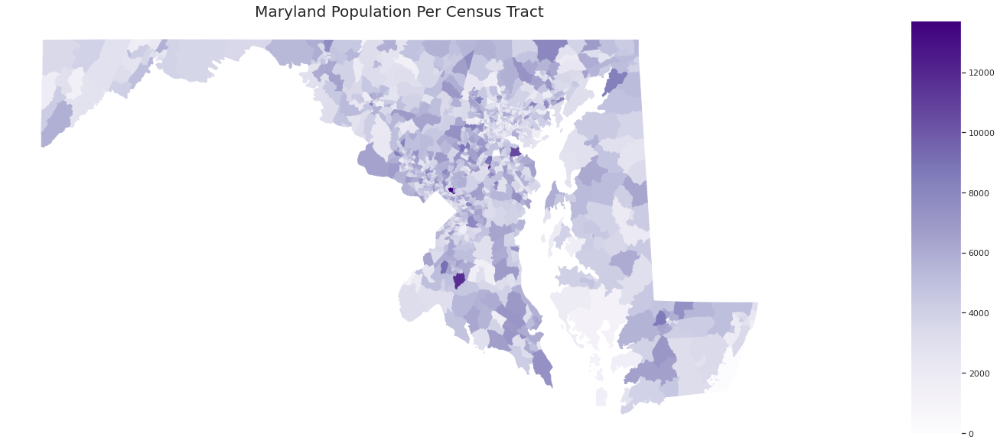

In [0]:
fig, ax = plt.subplots(figsize=(25,25))
ax.axis('off')
ax.set_title('Maryland Population Per Census Tract', fontsize=20)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
maryland['population'] = pd.to_numeric(maryland['population'])
maryland.plot(ax=ax, 
              column='population', 
              cmap='Purples',
              legend=True, 
              cax=cax,
              edgecolor="face",
              missing_kwds={"color": "lightgrey"})


In [0]:
#census_tract_query = """select count(person_id) AS cases, SUBSTRING(l.geoid, 1, 11) AS geoid_tract 
#from PERSONS_COVID_STATUS_CACHED p JOIN """+ databaseName +""".location l on p.location_id = l.location_id 
#where p.covid_status = 'Positive' group by geoid_tract"""

#Get the count of COVID positive patients by Goeid 
census_tract_query = """select count(person_id) AS cases, SUBSTRING(SUBSTRING(l.location_source_value, -15, 15),1, 11) AS geoid_tract 
from PERSONS_COVID_STATUS_CACHED p JOIN """+ databaseName +""".location l on p.location_id = l.location_id 
where p.covid_status = 'Positive' group by geoid_tract"""


location_data = sqlContext.sql(census_tract_query)
location_data = location_data.toPandas()
maryland_final = maryland.merge(location_data, how='left', 
                                           left_on='geoid',
                                           right_on='geoid_tract',                                  
                                           validate='one_to_one')

#Calculate the rate 
maryland_final['covid_rate_per_100k'] = (maryland_final['cases']/maryland_final['population']) * 100000

maryland_final.loc[maryland_final.cases.isna(),"cases"] = 0
maryland_final.loc[maryland_final.population == 0,"cases"] = 0
maryland_final.loc[maryland_final.population == 0,"covid_rate_per_100k"] = 0

/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):


In [0]:
cols=['name','population','cases','covid_rate_per_100k']
maryland_top_tracts = maryland_final.nlargest(n=10, columns=['covid_rate_per_100k'])
maryland_top_tracts = maryland_top_tracts[cols]
maryland_top_tracts['cases'] = maryland_top_tracts['cases'].astype(int)
maryland_top_tracts['covid_rate_per_100k']=maryland_top_tracts['covid_rate_per_100k'].apply(lambda x:round(x,2))
maryland_top_tracts = maryland_top_tracts.rename(columns={'name':'Census Tract', 'population':'Population','cases':'Cases', 'covid_rate_per_100k':'COVID Rate per 100k'})

s = maryland_top_tracts.to_html(index=False)
s = s.replace('<tr>\n      <th>Unnamed: 0 (N=n)</th>\n      <th>Unnamed: 1 (N=nan)</th>\n      <th></th>\n      <th></th>\n      <th></th>\n    </tr>\n ', '')
s = s.replace('Age_Groups', 'Age')
s = s.replace(' (N=', '</br>(N=')
s = s.replace(' (N=', '</br>(N=')
s = s.replace('border="1" class="dataframe"', 'classes=["table center"]')
displayHTML("""
<!DOCTYPE html>
<html>
<head>
<!-- Bootstrap CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@5.0.2/dist/css/bootstrap.min.css">
    <!-- Bootstrap Font Icon CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap-icons@1.5.0/font/bootstrap-icons.css">
<style>

th, td, tr {
    border-bottom: 1px solid black;
    text-align: left;  
    padding: 7px;
    padding-left: 40px;
    font-size:13px;
}
.center {
  margin: auto;
  width: 100%;
  text-align: center;
  padding: 20px;
  padding-left: 15%;
  padding-right: 15%;
  background: #f5f8fa;
  border: 1px solid #d3d3d3;
  border-radius: 8px;
  min-height: 10px;
  min-width: 10px  
}

</style>
<body>
</br>
<div class='center'>
<h5>
Top 10 Census Tracts in Maryland with the highest COVID cases per 100k
</h5>
</br>
"""+s+"""
</div>
</body>
</html>
""")

Census Tract,Population,Cases,COVID Rate per 100k
"Census Tract 9800, Anne Arundel, MD",7,8,114285.71
"Census Tract 7510.01, Frederick, MD",1166,547,46912.52
"Census Tract 4517.01, Baltimore, MD",4589,2115,46088.47
"Census Tract 4024.07, Baltimore, MD",1154,514,44540.73
"Census Tract 2, Wicomico, MD",1798,789,43882.09
"Census Tract 9705, Dorchester, MD",3577,1533,42857.14
"Census Tract 9500, Worcester, MD",1688,722,42772.51
"Census Tract 1101, Baltimore, MD",2860,1207,42202.80
"Census Tract 4, Washington, MD",1764,714,40476.19
"Census Tract 6.01, Washington, MD",2310,930,40259.74


/local_disk0/.ephemeral_nfs/envs/pythonEnv-e3ec1aae-4e4c-45c6-b0c7-1dd8274bd779/lib/python3.9/site-packages/geopandas/plotting.py:965: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  ax.get_figure().colorbar(n_cmap, **legend_kwds)


Out[42]: <AxesSubplot:title={'center':'Total COVID Cases Per 100k - Maryland (Census Tract)'}>

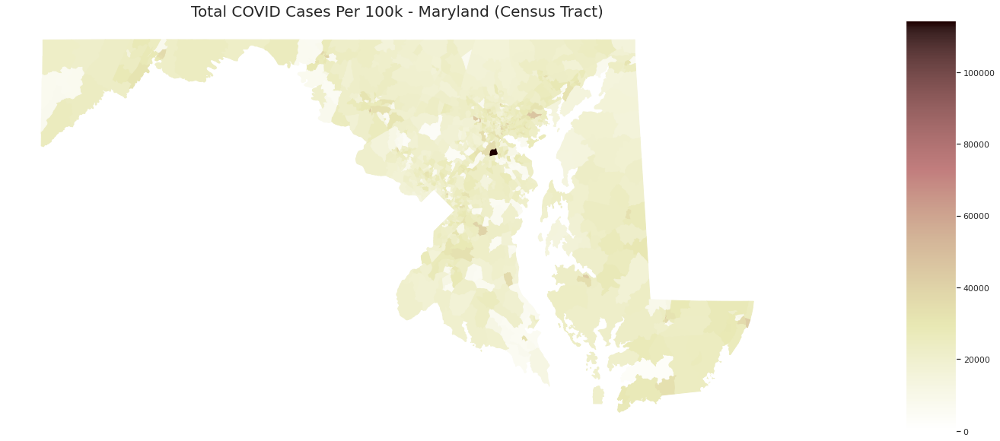

In [0]:
fig, ax = plt.subplots(figsize=(25,25))
ax.axis('off')
ax.set_title('Total COVID Cases Per 100k - Maryland (Census Tract)', fontsize=20)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)

maryland_final['covid_rate_per_100k'] = pd.to_numeric(maryland_final['covid_rate_per_100k'])
maryland_final.plot(ax=ax, 
              column='covid_rate_per_100k', 
              cmap='pink_r',
              legend=True, 
              cax=cax,
              edgecolor="face"
              #missing_kwds={"color": "blue"}
                   )

In [0]:
cols=['name','population','cases','covid_rate_per_100k']
baltimore = maryland_final[maryland_final['NAMELSADCO']=='Baltimore city']
baltimore_top_tracts = baltimore.nlargest(n=10, columns=['covid_rate_per_100k'])
baltimore_top_tracts = baltimore_top_tracts[cols]
baltimore_top_tracts['name'] = baltimore_top_tracts['name'].str.replace(', Baltimore, MD','')
baltimore_top_tracts['cases'] = baltimore_top_tracts['cases'].astype(int)
baltimore_top_tracts['covid_rate_per_100k']=baltimore_top_tracts['covid_rate_per_100k'].apply(lambda x:round(x,2))

baltimore_top_tracts = baltimore_top_tracts.rename(columns={'name':'Census Tract', 'population':'Population','cases':'Cases', 'covid_rate_per_100k':'COVID Rate per 100k'})

s = baltimore_top_tracts.to_html(index=False)
s = s.replace('<tr>\n      <th>Unnamed: 0 (N=n)</th>\n      <th>Unnamed: 1 (N=nan)</th>\n      <th></th>\n      <th></th>\n      <th></th>\n    </tr>\n ', '')
s = s.replace('Age_Groups', 'Age')
s = s.replace(' (N=', '</br>(N=')
s = s.replace(' (N=', '</br>(N=')
s = s.replace('border="1" class="dataframe"', 'classes=["table center"]')
displayHTML("""
<!DOCTYPE html>
<html>
<head>
<!-- Bootstrap CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@5.0.2/dist/css/bootstrap.min.css">
    <!-- Bootstrap Font Icon CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap-icons@1.5.0/font/bootstrap-icons.css">
<style>

th, td, tr {
    border-bottom: 1px solid black;
    text-align: left;  
    font-size:13px;
    padding: 4px;
}
.center {
  margin: auto;
  width: 100%;
  text-align: center;
  padding: 20px;
  background: #f5f8fa;
  border: 1px solid #d3d3d3;
  border-radius: 8px;
  min-height: 10px;
  min-width: 10px  
}

</style>
<body>
</br>
<div class='center'>
<h6>
Top 10 Census Tracts in Baltimore city with the highest COVID cases per 100k
</h6>
</br>
"""+s+"""
</div>
</body>
</html>
""")

Census Tract,Population,Cases,COVID Rate per 100k
Census Tract 1101,2860,1207,42202.80
Census Tract 1501,1912,764,39958.16
Census Tract 802,796,314,39447.24
Census Tract 2303,1270,500,39370.08
Census Tract 401,4869,1912,39268.84
Census Tract 807,787,285,36213.47
Census Tract 1702,2074,736,35486.98
Census Tract 604,1875,654,34880.00
Census Tract 2002,1841,634,34437.81
Census Tract 2804.02,1283,441,34372.56


In [0]:
cols=['name','population','cases','covid_rate_per_100k']
baltimore = maryland_final[maryland_final['NAMELSADCO']=='Baltimore city']
baltimore_top_tracts = baltimore.nsmallest(n=10, columns=['covid_rate_per_100k'])
baltimore_top_tracts = baltimore_top_tracts[cols]
baltimore_top_tracts['name'] = baltimore_top_tracts['name'].str.replace(', Baltimore, MD','')
baltimore_top_tracts['cases'] = baltimore_top_tracts['cases'].astype(int)
baltimore_top_tracts['covid_rate_per_100k']=baltimore_top_tracts['covid_rate_per_100k'].apply(lambda x:round(x,2))

baltimore_top_tracts = baltimore_top_tracts.rename(columns={'name':'Census Tract', 'population':'Population','cases':'Cases', 'covid_rate_per_100k':'COVID Rate per 100k'})

s = baltimore_top_tracts.to_html(index=False)
s = s.replace('<tr>\n      <th>Unnamed: 0 (N=n)</th>\n      <th>Unnamed: 1 (N=nan)</th>\n      <th></th>\n      <th></th>\n      <th></th>\n    </tr>\n ', '')
s = s.replace('Age_Groups', 'Age')
s = s.replace(' (N=', '</br>(N=')
s = s.replace(' (N=', '</br>(N=')
s = s.replace('border="1" class="dataframe"', 'classes=["table center"]')
displayHTML("""
<!DOCTYPE html>
<html>
<head>
<!-- Bootstrap CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@5.0.2/dist/css/bootstrap.min.css">
    <!-- Bootstrap Font Icon CSS -->
    <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap-icons@1.5.0/font/bootstrap-icons.css">
<style>

th, td, tr {
    border-bottom: 1px solid black;
    text-align: left;  
    font-size:13px;
    padding: 4px;
}
.center {
  margin: auto;
  width: 100%;
  text-align: center;
  padding: 20px;
  background: #f5f8fa;
  border: 1px solid #d3d3d3;
  border-radius: 8px;
  min-height: 10px;
  min-width: 10px  
}

</style>
<body>
</br>
<div class='center'>
<h6>
10 Census Tracts in Baltimore city with the lowest COVID cases per 100k
</h6>
</br>
"""+s+"""
</div>
</body>
</html>
""")

Census Tract,Population,Cases,COVID Rate per 100k
Census Tract 2506,0,0,0.00
Census Tract 2711.02,5155,205,3976.72
Census Tract 2709.03,5261,600,11404.68
Census Tract 2806,3137,366,11667.20
Census Tract 2715.03,844,102,12085.31
Census Tract 2803.02,3980,543,13643.22
Census Tract 1301,3393,493,14529.91
Census Tract 2712,6281,1008,16048.40
Census Tract 1202.01,2162,353,16327.47
Census Tract 2702,1779,291,16357.50


/local_disk0/.ephemeral_nfs/envs/pythonEnv-e3ec1aae-4e4c-45c6-b0c7-1dd8274bd779/lib/python3.9/site-packages/geopandas/plotting.py:965: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  ax.get_figure().colorbar(n_cmap, **legend_kwds)


Out[45]: <AxesSubplot:title={'center':'Total COVID Cases Per 100k - Baltimore City (Census Tract)'}>

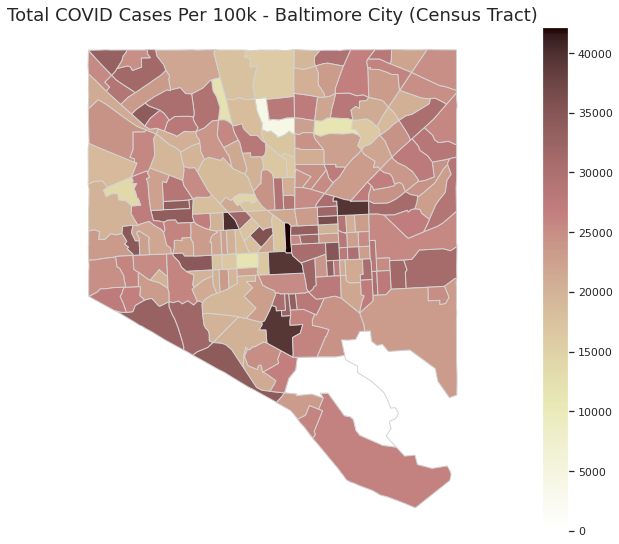

In [0]:
fig, ax = plt.subplots(figsize=(10,10))
ax.axis('off')
ax.set_title('Total COVID Cases Per 100k - Baltimore City (Census Tract)', fontsize=18)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)

maryland_final['covid_rate_per_100k'] = pd.to_numeric(maryland_final['covid_rate_per_100k'])
baltimore = maryland_final[maryland_final['NAMELSADCO']=='Baltimore city']
baltimore.plot(ax=ax, 
              column='covid_rate_per_100k', 
              cmap='pink_r',
              legend=True, 
              edgecolor="lightgrey",               
              cax=cax,
              missing_kwds={"color": "lightgrey"})

#### Venn Diagrams (Visit types)

In [0]:
positive_patients_query="""Select distinct(person_id) person_id, 1 cov_positive from COVID_POSITIVE_PERSONS"""
dataframe = sqlContext.sql(positive_patients_query)
covid_positive = dataframe.toPandas()

covid_tests_query="""Select distinct(person_id) person_id, 1 cov_tested from COVID_TESTS"""
dataframe = sqlContext.sql(covid_tests_query)
covid_tested = dataframe.toPandas()

vent_procedures_query="""Select distinct(person_id) person_id, 1 has_vent from """+databaseName+""".procedure_occurrence p where p.procedure_concept_id in (select distinct concept_id from COVID_VENT_CONCEPT_SET) AND p.procedure_datetime> '2020-11-01'"""
dataframe = sqlContext.sql(vent_procedures_query)
has_vent = dataframe.toPandas()

visit_types_query = """select distinct person_id, outpatient, inpatient, outpatient_ed from (Select person_id, 
CASE WHEN visit_concept_name in ('Outpatient Visit','Observation Room') then 1 ELSE 0 END outpatient, 
CASE WHEN visit_concept_name='Inpatient Visit' THEN 1  ELSE 0 END inpatient,
CASE WHEN visit_source_value='Outpatient with ED' THEN 1  ELSE 0 END outpatient_ed  
from """+databaseName+""".visit_occurrence v where  v.visit_start_date> '2020-11-01') x"""
dataframe = sqlContext.sql(visit_types_query)
visit_types = dataframe.toPandas()

covid_vaccinated_query="""Select distinct d.person_id person_id, 1 vaccinated
from """+databaseName+""".drug_exposure d  where UPPER(d.drug_concept_id) in (select distinct concept_id from """+omopconcepts+""".concept_sets where concept_set_name='Covid Vaccination') AND drug_exposure_start_date> '2020-11-01'"""
dataframe = sqlContext.sql(covid_vaccinated_query)
covid_vaccinated = dataframe.toPandas()

/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distuti

In [0]:
venn_df = covid_tested.merge(covid_positive,on='person_id', how="outer").merge(has_vent,on='person_id',how="outer").merge(visit_types,on='person_id',how="outer").merge(covid_vaccinated,on='person_id',how="outer")

In [0]:
s = venn_df.loc[venn_df['cov_positive']==1][['person_id']].to_dict('list')
my_list = s.get('person_id')
cov_positive_set = {}
cov_positive_set = {e for e in my_list}

s = venn_df.loc[venn_df['cov_tested']==1][['person_id']].to_dict('list')
my_list = s.get('person_id')
cov_tested_set = {}
cov_tested_set = {e for e in my_list}

s = venn_df.loc[venn_df['vaccinated']==1][['person_id']].to_dict('list')
my_list = s.get('person_id')
vaccinated_set = {}
vaccinated_set = {e for e in my_list}

s = venn_df.loc[venn_df['has_vent']==1][['person_id']].to_dict('list')
my_list = s.get('person_id')
has_vent_set = {}
has_vent_set = {e for e in my_list}

s = venn_df.loc[venn_df['inpatient']==1][['person_id']].to_dict('list')
my_list = s.get('person_id')
inpatient_set = {}
inpatient_set = {e for e in my_list}

s = venn_df.loc[venn_df['outpatient']==1][['person_id']].to_dict('list')
my_list = s.get('person_id')
outpatient_set = {}
outpatient_set = {e for e in my_list}

Out[49]: <AxesSubplot:>

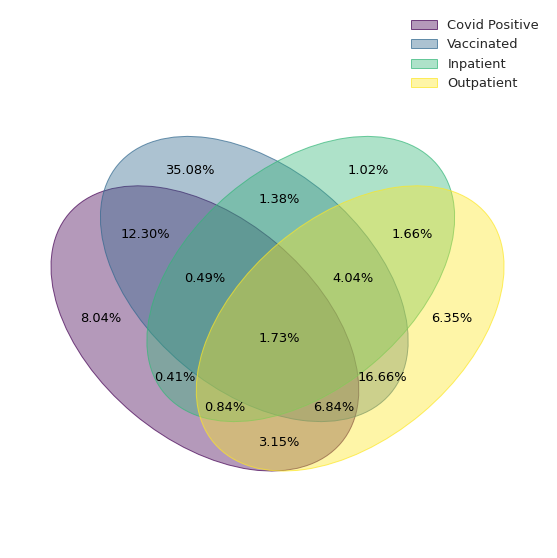

In [0]:
from venn import venn
%matplotlib inline

venn_groups = {
    "Covid Positive": cov_positive_set,
    #"Covid Tested": cov_tested_set,
    "Vaccinated": vaccinated_set,
    "Inpatient": inpatient_set,
    "Outpatient": outpatient_set,
    #"Has Ventilation": has_vent_set
}
venn(venn_groups, fmt='{percentage:.2f}%',figsize=(10, 10))

Out[50]: <AxesSubplot:>

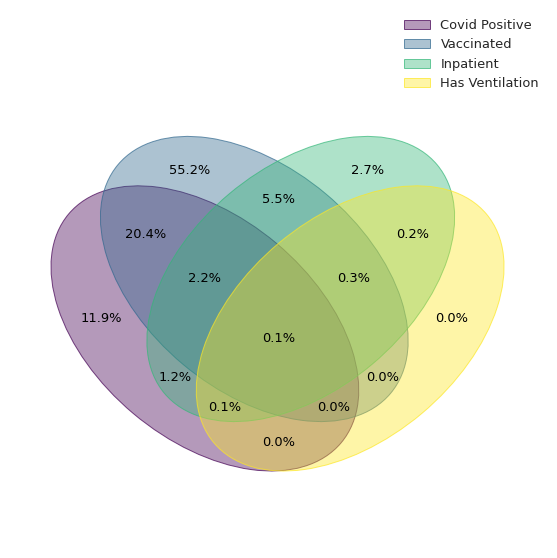

In [0]:
from venn import venn
%matplotlib inline

venn_groups = {
    "Covid Positive": cov_positive_set,
    "Vaccinated": vaccinated_set,
    "Inpatient": inpatient_set,
    #"Outpatient": outpatient_set,
    "Has Ventilation": has_vent_set
}
venn(venn_groups, fmt='{percentage:.1f}%', figsize=(10, 10))

#### Comorbidities

In [0]:
comorbidities_query = """select co.person_id, c.concept_set_name AS Disease
from """+databaseName+""".condition_occurrence_domain_map co 
left join """+omopconcepts+""".concept_sets_v2 c on c.concept_id=co.condition_concept_id
where lower(c.concept_set_name) like '%diabet%'
  OR lower(c.concept_set_name) like '%cancer%'
  OR lower(c.concept_set_name) like '%kidney%'
  OR lower(c.concept_set_name) like '%chronic lung disease%' 
  OR lower(c.concept_set_name) like '%myocardial%'
  OR lower(c.concept_set_name) like '%congestive%'
  OR lower(c.concept_set_name) like '%liver%'
  OR lower(c.concept_set_name) like '%dementia%'
  OR lower(c.concept_set_name) like '%rheuma%'
"""

dataframe = sqlContext.sql(comorbidities_query)
df_comobidities = dataframe.toPandas()

#Transpose comorbidities dataframe and reset index 
df_comobidities_t = pd.crosstab(df_comobidities['person_id'],df_comobidities['Disease'])
df_comobidities_t = df_comobidities_t.reset_index()

all_patients_query = """select p.person_id, 
CASE WHEN p.COVID_STATUS='Positive' THEN 1 ELSE 0 END AS COVID, 
CASE WHEN d.person_id is not null THEN 1 ELSE 0 END AS DEAD
from PERSONS_COVID_STATUS_CACHED p 
left join """+databaseName+""".death d on p.person_id=d.person_id
"""

dataframe = sqlContext.sql(all_patients_query)
all_patients = dataframe.toPandas()

/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distuti

In [0]:
disease_cols= ['CHRONIC LUNG DISEASE',
       'CONGESTIVE HEART FAILURE', 'DEMENTIA', 'DIABETES COMPLICATED',
       'DIABETES UNCOMPLICATED', 'KIDNEY DISEASE', 'MALIGNANT CANCER',
       'METASTATIC SOLID TUMOR CANCERS', 'MILD LIVER DISEASE',
       'MODERATE OR SEVERE LIVER DISEASE', 'MYOCARDIAL INFARCTION',
       'RHEUMATOLOGIC DISEASE']

#Merge with all patients dataframe to get COVID status
df_comorbidities_final = all_patients.merge(df_comobidities_t, on='person_id', how='left')

#Merge with venn_df which has visit types for each patient
df_comorbidities_final = df_comorbidities_final.merge(venn_df, how='left', on='person_id')
df_comorbidities_final = df_comorbidities_final.fillna(0)


df_comorbidities_final = df_comorbidities_final.astype(np.int64)

#We will keep only COVID patients (We are inetersted in Comorbidity distribution of COVID patients) 
df_comorbidities_final = df_comorbidities_final[df_comorbidities_final['COVID']==1]

df_comorbidities_final = df_comorbidities_final.groupby('person_id').sum()
df_comorbidities_final = df_comorbidities_final.reset_index()

for c in df_comorbidities_final.columns:
  if(c!='person_id'):
    df_comorbidities_final[c] = df_comorbidities_final[c].apply(lambda x: 1 if x > 0 else 0)

df_comorbidities_final = df_comorbidities_final[df_comorbidities_final['COVID']==1]

In [0]:
df_comorbidities_final.shape

Out[53]: (1500778, 22)

In [0]:
results_all_covid = df_comorbidities_final[disease_cols].sum(axis=0)/df_comorbidities_final.shape[0]
results_all_covid = pd.DataFrame(results_all_covid, columns=['All COVID+'])

df_comorbidities_mortality = df_comorbidities_final[df_comorbidities_final['DEAD']==1]
results_mortality = df_comorbidities_mortality[disease_cols].sum(axis=0)/df_comorbidities_mortality.shape[0]
results_mortality = pd.DataFrame(results_mortality, columns=['Mortality'])

#Severe = inpatient and intubated (COVID_VENT_CONCEPT_SET)
df_comorbidities_severe = df_comorbidities_final[df_comorbidities_final['has_vent']==1]
results_severe = df_comorbidities_severe[disease_cols].sum(axis=0)/df_comorbidities_severe.shape[0]
results_severe = pd.DataFrame(results_severe, columns=['Severe'])

#Moderate = Inpatient without Intubated and ECMO
df_comorbidities_moderate = df_comorbidities_final[(df_comorbidities_final['has_vent']==0) & (df_comorbidities_final['inpatient']==1)]
results_moderate = df_comorbidities_moderate[disease_cols].sum(axis=0)/df_comorbidities_moderate.shape[0]
results_moderate = pd.DataFrame(results_moderate, columns=['Moderate'])

#Mild ED = Outpatient ED
df_comorbidities_mild_ed = df_comorbidities_final[(df_comorbidities_final['has_vent']==0) & (df_comorbidities_final['inpatient']==0) & (df_comorbidities_final['outpatient_ed']==1)]
results_mild_ed = df_comorbidities_mild_ed[disease_cols].sum(axis=0)/df_comorbidities_mild_ed.shape[0]
results_mild_ed = pd.DataFrame(results_mild_ed, columns=['Mild ED'])

#Mild = Observation + Oupatient (not ED)
df_comorbidities_mild = df_comorbidities_final[(df_comorbidities_final['has_vent']==0) & (df_comorbidities_final['inpatient']==0) & (df_comorbidities_final['outpatient_ed']==0) & (df_comorbidities_final['outpatient']==1)]
results_mild = df_comorbidities_mild[disease_cols].sum(axis=0)/df_comorbidities_mild.shape[0]
results_mild = pd.DataFrame(results_mild, columns=['Mild'])

In [0]:
df_comorbidities_final.shape

Out[55]: (1500778, 22)

In [0]:
df_com_distribution = pd.concat([results_mild, results_mild_ed, results_moderate, results_severe, results_mortality,results_all_covid], ignore_index=False, sort=True, axis=1)
df_com_distribution.index = df_com_distribution.index.str.title()
format_dict = {'All COVID+': '{:.2%}', 'Mortality': '{:.2%}', 'Severe': '{:.2%}', 'Moderate': '{:.2%}', 'Mild ED': '{:.2%}', 'Mild': '{:.2%}'}
df_com_distribution.style.background_gradient(axis=None,low=0, high=1).format(format_dict).set_properties(**{'border': '1.3px solid green', 'padding': '10px', 'text-align': 'Center'})


,Mild,Mild ED,Moderate,Severe,Mortality,All COVID+
Chronic Lung Disease,11.91%,16.31%,27.31%,47.07%,36.43%,9.07%
Congestive Heart Failure,1.46%,1.06%,12.26%,30.06%,29.82%,1.95%
Dementia,0.87%,1.38%,8.67%,12.81%,35.50%,1.64%
Diabetes Complicated,6.03%,5.09%,21.51%,47.26%,40.11%,4.60%
Diabetes Uncomplicated,12.83%,11.17%,30.10%,52.37%,46.32%,8.20%
Kidney Disease,5.00%,4.09%,26.41%,64.86%,59.81%,4.92%
Malignant Cancer,6.20%,1.97%,9.04%,12.98%,19.06%,2.15%
Metastatic Solid Tumor Cancers,0.96%,0.32%,2.51%,3.96%,7.62%,0.46%
Mild Liver Disease,0.80%,0.60%,3.31%,8.67%,6.75%,0.64%
Moderate Or Severe Liver Disease,0.28%,0.18%,1.68%,12.59%,7.52%,0.35%



https://unite.nih.gov/workspace/module/view/latest/ri.workshop.main.module.452c6c44-36d0-49d5-b96f-b8bcefab9d67?view=focus&id=dcde5b61-6f0b-4cdb-9156-582accea6f2c

**Important:** The numbers look off for mortality. The definition for COVID mortality should be updated to take in consideration time from the date of COVID. Some people with comobidites will die from their diseases and not COVID. The severity indicators should also use a temporal window from the date of the (last) COVID infection

For now we are using:
- Mortality = COVID postive with a death record 
- Severe = inpatient and intubated (COVID_VENT_CONCEPT_SET)
- Moderate = Inpatient without Intubated and ECMO
- Mild ED = Outpatient ED
- Mild = Observation + Oupatient 


Logic Liaison: Severity Type Definition

Severity Type (ranked events around the time of COVID index)

Please be cautious in your interpretation and use of this derived variable. "Severity" is difficult to determine using this observational dataset. It is not possible to know if the ED, hospitalization, IMV and ECMO events where caused by the COVID_infection. Thus our score is temporal rather than causal in relation to the COVID-19 infection. 

By applying the CDC definition of hospitalization described above in the COVID_associated_hospitalization_indicator section, and by basing our logic purely on events around the time of the COVID index event, we are being conservative in assigning below grades. The value is derived as follows:

“No_COVID_index” for anyone who does not have either a positive COVID PCR or AG lab test or a COVID diagnosis charted

“Death_after_COVID_index” for anyone not already in previous category who has a value of 1 for COVID_patient_death_indicator

“Severe_ECMO_IMV_in_Hosp_around_COVID_index” for anyone not already in previous category who has a value of 1 for either LL_ECMO_during_covid_hospitalization_indicator or LL_IMV_during_covid_hospitalization_indicator

“Moderate_Hosp_around_COVID_index” for anyone not already in previous category who has a non-null value for first_COVID_hospitalization_start_date

“Mild_ED_around_COVID_index” for anyone not already in previous category who has non-null value for first_COVID_ED_only_start_date
Otherwise “Mild_No_ED_or_Hosp_around_COVID_index”

Of note, COVID_patient_death_indicator reflects both deaths and discharges to hospice from the death and visit domains as of 7/15/2022.


In [0]:
%r
databaseName=dbutils.widgets.get('databaseName')
query=paste("select * from ",databaseName,".person",sep="")
print(query)

[1] "select * from crisp_omop.person"

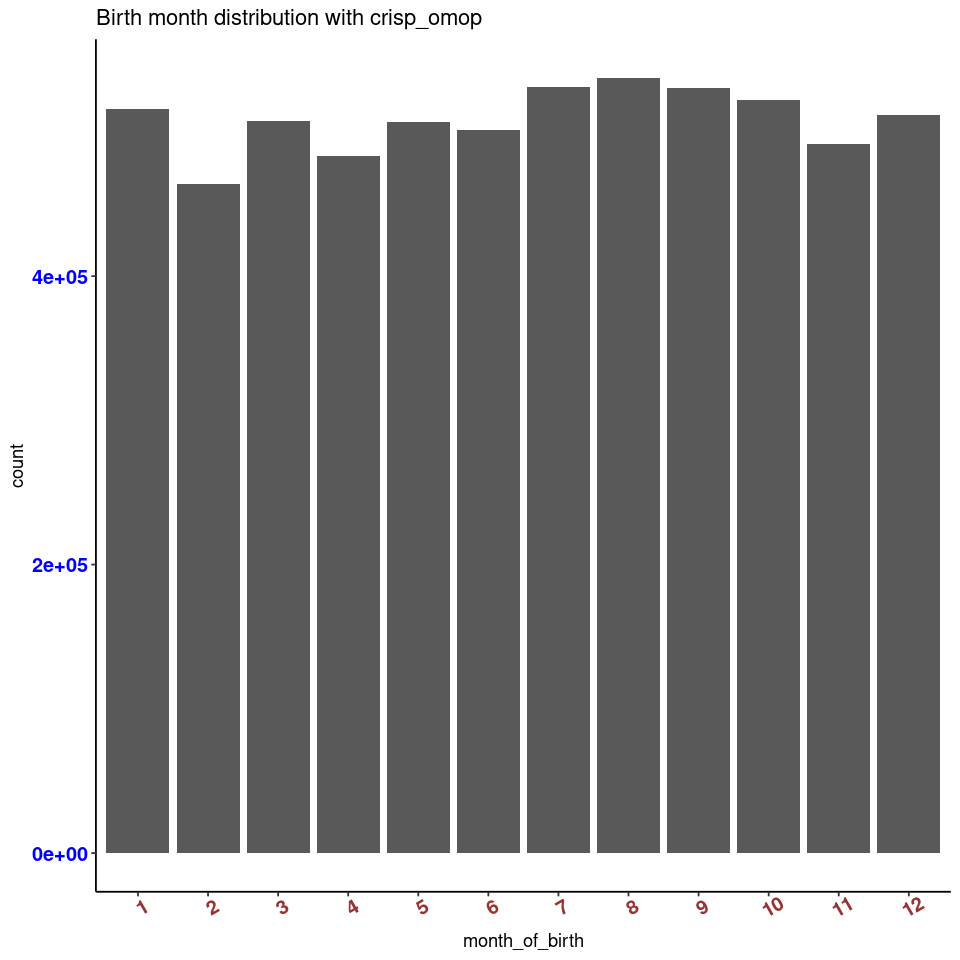

month_of_birth,count
12,511503
1,516128
6,501485
3,507480
5,506982
9,530236
4,483459
8,537376
7,530809
10,522411


Loading required package: SparkR

Attaching package: ‘SparkR’

The following object is masked _by_ ‘.GlobalEnv’:

    setLocalProperty

The following objects are masked from ‘package:stats’:

    cov, filter, lag, na.omit, predict, sd, var, window

The following objects are masked from ‘package:base’:

    as.data.frame, colnames, colnames<-, drop, endsWith, intersect,
    rank, rbind, sample, startsWith, subset, summary, transform, union

Loading required package: ggplot2

Attaching package: ‘ggplot2’

The following object is masked from ‘package:SparkR’:

    expr

SparkDataFrame[person_id:int, gender_concept_id:int, mapped_gender:string, year_of_birth:int, month_of_birth:int, day_of_birth:int, birth_datetime:timestamp, race_concept_id:int, ethnicity_concept_id:int, location_id:bigint, provider_id:int, care_site_id:int, person_source_value:string, gender_source_value:string, gender_source_concept_id:int, race_source_value:string, race_source_concept_id:int, ethnicity_source_value:str

In [0]:
%r
databaseName=dbutils.widgets.get('databaseName')
require(SparkR)
require(ggplot2)
person <- sql("select * from crisp_08sept2022.person")
print(person)
#sum <- summarize(groupBy(person, person$race_source_value), count = n(person$race_source_value))
# sum <- summarize(groupBy(person, person$month_of_birth), count = n(person$month_of_birth))
sum <- summarize(groupBy(person, person$month_of_birth), count = n(person$month_of_birth))
display(sum)
sum2 <- collect(sum)
plot <- ggplot(data = sum2, aes(x = month_of_birth,y = count)) +
        geom_bar(stat = "identity")

plot + theme(axis.text.x = element_text(face = "bold", color = "#993333",
                           size = 12, angle = 30),
          axis.text.y = element_text(face = "bold", color = "blue",
                           size = 12, angle = 0)) +
          scale_x_discrete(limit = c("1", "2", "3","4","5","6","7",'8','9','10','11','12')) +
          ggtitle(paste("Birth month distribution with",databaseName,sep=" ")) +  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
panel.background = element_blank(), axis.line = element_line(colour = "black"))

In [0]:
######################################### construction zone

In [0]:
%sql
-- visit with covid

-- SELECT 1 as covid_dx, *
-- FROM crisp_08sept2022.condition_occurrence_domain_map
-- where lower(condition_concept_name) like ('%cov%')


SELECT count(*)
FROM crisp_08sept2022.condition_occurrence_domain_map
where lower(condition_concept_name) like ('%cov%')




count(1)
338592


In [0]:
visit_w_covid_query="""Select count(*) visit_w_covid from """+databaseName+""".condition_occurrence_domain_map where lower(condition_concept_name) like ('%cov%') """
dataframe = sqlContext.sql(visit_w_covid_query)
pandasDF = dataframe.toPandas()
visit_cov = human_format(pandasDF.visit_w_covid[0])
print(visit_cov)

/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:37: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pandas.__version__) < LooseVersion(minimum_pandas_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):
/databricks/spark/python/pyspark/sql/pandas/utils.py:64: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(pyarrow.__version__) < LooseVersion(minimum_pyarrow_version):


338.59k
